**First exercise:**

- Load the thermal image 'FLIR_00021.jpeg’
- Let’s suppose that the temperature corresponds to 0.1*pixel value
- Display the image using a diverging colormap centered at 12 degrees, mapping the 
colormap in the range 4-20 degrees
- Add contours corresponding to 4,8,12,16,20 degrees

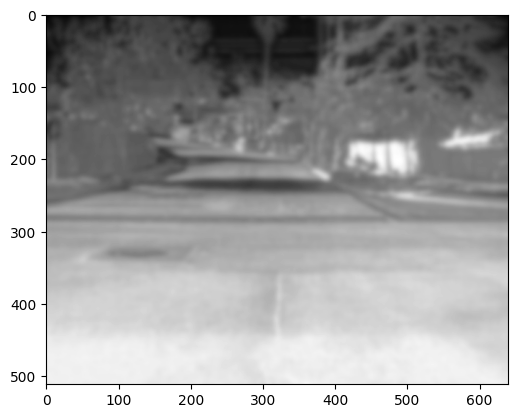

In [2]:
import matplotlib
import numpy as np
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pydicom
from pydicom import dcmread
from pydicom.data import get_testdata_file


img = mpimg.imread('FLIR_00021.jpeg')
plt.imshow(img, cmap=plt.cm.gray) #the usual colormap here is grayscale!

In [3]:
import plotly.express as px
import plotly.graph_objects as go

fig = px.imshow(img, color_continuous_scale='gray', zmin=40, zmax=200)

fig.add_trace(go.Contour(z=img, showscale=True,
                         contours=dict(start=40, end=200, size=40, coloring='lines'),
                         line_width=2,
                         colorbar=dict(
                         x=-0.2
                         )
                         ))

fig.show()
                         

In [4]:
# Convert pixel values to temperature
temperature = img * 0.1

# Display the image using a diverging colormap centered at 12 degrees
fig = px.imshow(temperature, color_continuous_scale='RdBu', zmin=4, zmax=20, labels={'color': 'Temperature (°C)'})

# Update the color axis to set the midpoint
fig.update_coloraxes(cmid=12)

# Add contours corresponding to 4, 8, 12, 16, 20 degrees
fig.add_trace(go.Contour(z=temperature, showscale=False,
                         contours=dict(start=4, end=20, size=4, coloring='lines'),
                         line_width=2,
                         colorscale='gray'))

fig.update_layout(title='Thermal Image with Temperature Contours')
fig.show()